<a href="https://colab.research.google.com/github/DEVIL22664488/Eye-Blinking-AI-project/blob/main/Eye_Blinking_AI_model_using_python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install cvzone
!pip install matplotlib
!pip install mediapipe

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for cvzone: filename=cvzone-1.5.6-py3-none-any.whl size=18767 sha256=dc1aca2dd794e64ce8d756279313be3bae4c96cf3ae9cdf710f77f794ee45cb9
  Stored in directory: /root/.cache/pip/wheels/67/60/9a/e5060027d8eae2c01ba872fdbc094a6fe3fee15794ee3dc709
Successfully built cvzone
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.0/33.0 MB 50.0 MB/s eta 0:00:00


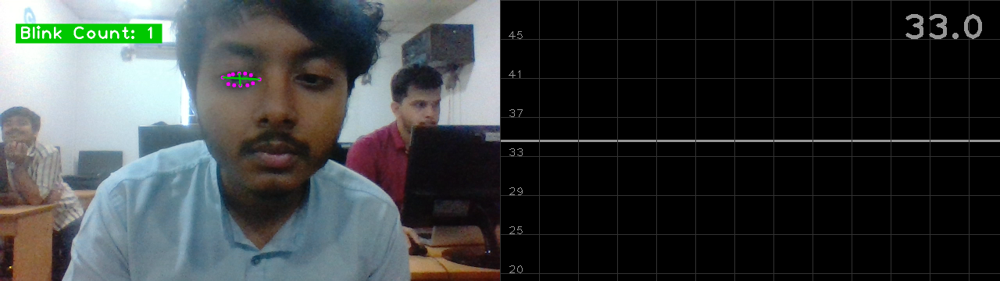

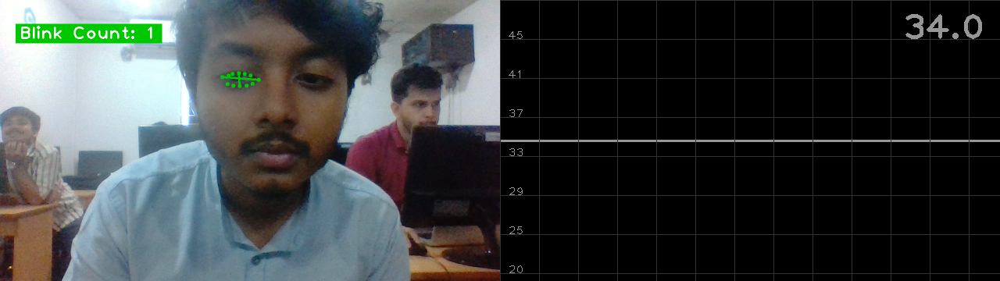

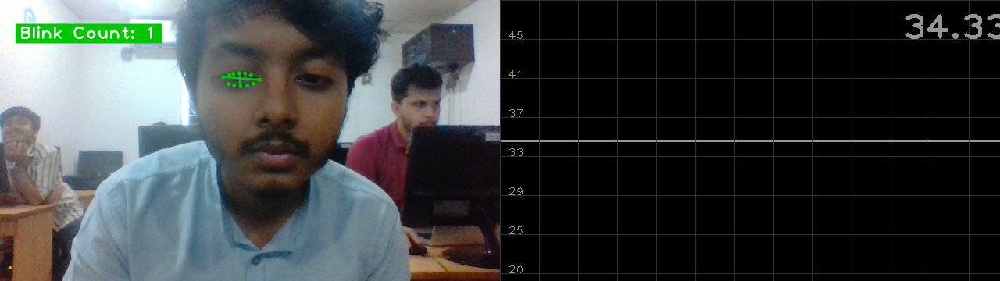

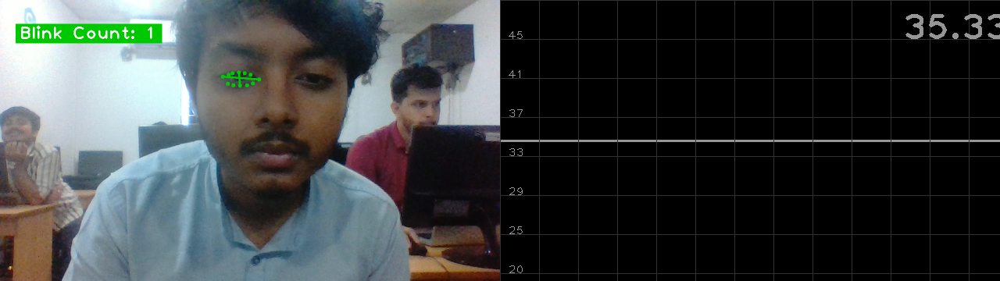

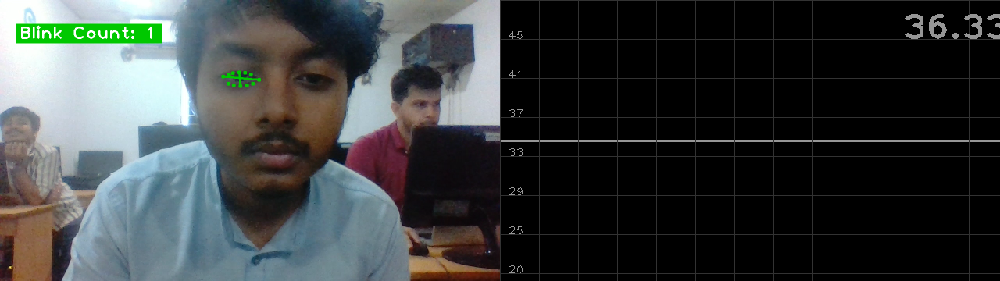

...

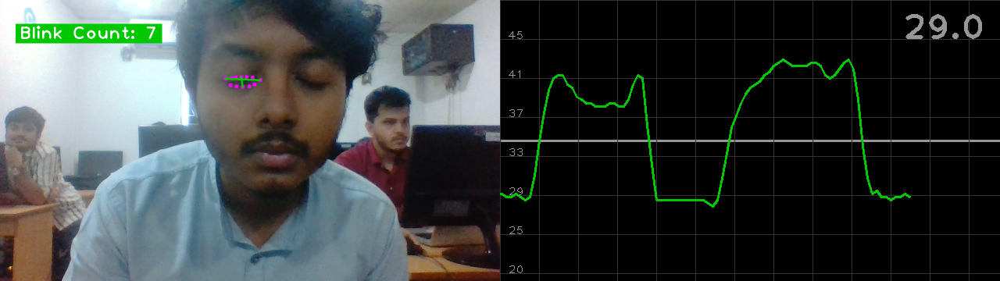

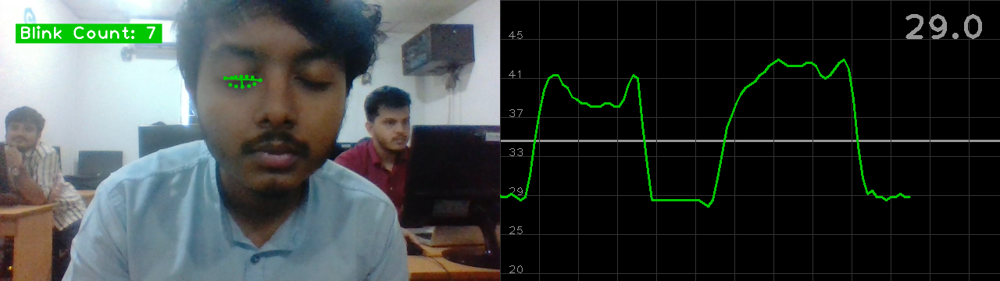

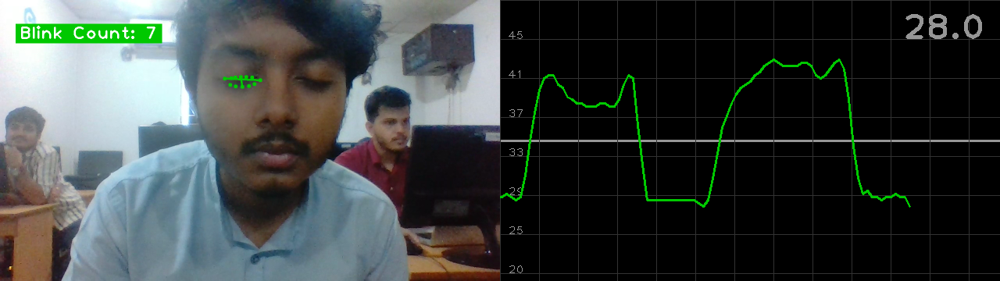

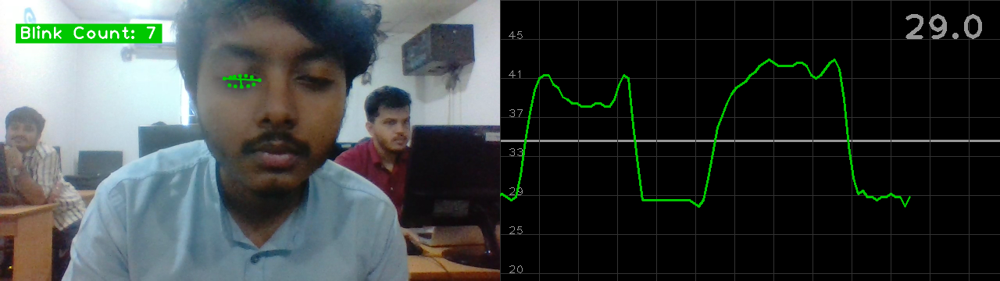

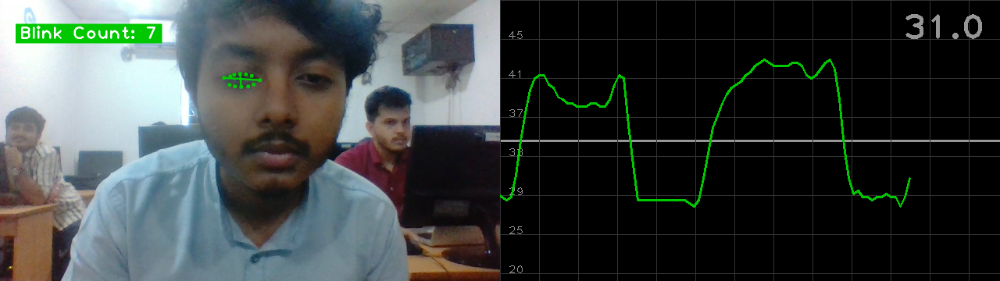

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import cvzone
import matplotlib.pyplot as plt
from cvzone.FaceMeshModule import FaceMeshDetector
from cvzone.PlotModule import LivePlot
from google.colab.patches import cv2_imshow

cap = cv2.VideoCapture('/content/drive/MyDrive/Circuit PDF/WIN_20230301_14_58_17_Pro.mp4')
detector = FaceMeshDetector(maxFaces=1)
plotY = LivePlot(640, 360, [20, 50], invert=True)

idList = [22, 23, 24, 26, 110, 157, 158, 159, 160, 161, 130, 243]
ratioList = []
blinkCounter = 0
counter = 0
color = (255, 0, 255)

while True:

    if cap.get(cv2.CAP_PROP_POS_FRAMES) == cap.get(cv2.CAP_PROP_FRAME_COUNT):
        cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

    success, img = cap.read()
    img, faces = detector.findFaceMesh(img, draw=False)

    if faces:
        face = faces[0]
        for id in idList:
            cv2.circle(img, face[id], 5,color, cv2.FILLED)

        leftUp = face[159]
        leftDown = face[23]
        leftLeft = face[130]
        leftRight = face[243]
        lenghtVer, _ = detector.findDistance(leftUp, leftDown)
        lenghtHor, _ = detector.findDistance(leftLeft, leftRight)

        cv2.line(img, leftUp, leftDown, (0, 200, 0), 3)
        cv2.line(img, leftLeft, leftRight, (0, 200, 0), 3)

        ratio = int((lenghtVer / lenghtHor) * 100)
        ratioList.append(ratio)
        if len(ratioList) > 3:
            ratioList.pop(0)
        ratioAvg = sum(ratioList) / len(ratioList)

        if ratioAvg < 35 and counter == 0:
            blinkCounter += 1
            color = (0,200,0)
            counter = 1
        if counter != 0:
            counter += 1
            if counter > 10:
                counter = 0
                color = (255,0, 255)

        cvzone.putTextRect(img, f'Blink Count: {blinkCounter}', (50, 100),
                           colorR=color)

        imgPlot = plotY.update(ratioAvg, color)
        img = cv2.resize(img, (640, 360))
        imgStack = cvzone.stackImages([img, imgPlot], 2, 1)
    else:
        img = cv2.resize(img, (640, 360))
        imgStack = cvzone.stackImages([img, img], 2, 1)

    cv2_imshow(imgStack)
    cv2.waitKey(25)